![HACKTIV8](datasets/h8.png)

---
# Capstone Project 2

Nama Anggota:
  1. Oktaviani (PYTN-KS16-002)
  2. Gladis Hafifah (PYTN-KS16-001)
  3. Muhammad Rayhan Assegaf (PYTN-KS16-022)
---

## Introduction
Australia merupakan sebuah negara yang sangat besar dan bervariasi secara geografis, sehingga cuacanya sangat beragam dari suatu wilayah ke wilayah lainnya. mulai dari iklim tropis di wilayah utara australia dengan musim basah pada bulan November hingga April, dan musim kering pada bulan mei hingga oktober. Secara umum negara australia memiliki empat musim diantaranya musim panas dari bulan desember hingga febuari, musim gugur pada bulan maret hingga mei, musim dingin pada bulan juni hingga agustus, dan musim semi pada bulan september hingga november. 

"WeatherAUS" adalah sekumpulan data yang berisikan pengamatan cuaca harian yang ada disetiap wilayah negara australia, selama sekitar 10 tahun, Dataset ini mencangkup aspek cuaca seperti, kelembaban, suhu, curah hujan, cakupan awan, dan perkiraan cuaca. Ada 145460 entries dalam dataset ini dengan 23 atribut yang mencangkup informasi tentang cuaca harian.

Atribut "RainTomorrow" adalah target variabel dalam dataset ini. Jika nilainya adalah "Yes," itu berarti bahwa besok kemungkinan akan turun hujan. Dataset ini bermanfaat untuk analisis cuaca, pemodelan cuaca, dan pengembangan sistem peramalan cuaca. Sumber dataset ini adalah platform Kaggle, yang merupakan sumber data yang populer untuk berbagai proyek analisis data dan pembelajaran mesin.

This dataset contains:
- Date: tanggal hari itu.
- Location: lokasi, nama kota di Australia.
- MinTemp: temperatur terendah hari itu dalam celcius.
- MaxTemp: temperatur tertinggi hari itu dalam celcius.
- Rainfall: jumlah curah hujan hari itu dalam mm.
- Evaporation: jumlah evaporasi dalam mm dari Class A pan selama 24 jam sebelum jam 9 pagi hari itu.
- Sunshine: jumlah jam hari itu cerah dengan cahaya matahari.
- WindGustDir: arah kecepatan angin yang paling tinggi selama 24 jam sebelum jam 12 malam hari itu.
- WindGustSpeed: kecepatan angin yang paling tinggi dalam km/jam selama 24 jam sebelum jam 12 malam hari itu.
- WindDir9am: arah angin jam 9 pagi.
- WindDir3pm: arah angin jam 3 sore.
- WindSpeed9am: kecepatan angin jam 9 pagi dalam km/jam dihitung dari rata-rata kecepatan angin 10 menit sebelum jam 3 sore.
- WindSpeed3pm: kecepatan angin jam 3 sore dalam km/jam dihitung dari rata-rata kecepatan angin 10 menit sebelum jam 3 sore.
- Humidity9am: humiditas jam 9 pagi dalam persen.
- Humidity3pm: humiditas jam 3 sore dalam persen.
- Pressure9am: tekanan udara jam 9 pagi dalam hpa.
- Pressure3pm: tekanan udara jam 3 sore dalam hpa.
- Cloud9am: persentase langit yang tertutup awan jam 9 pagi. dihitung dalam oktas, unit ⅛, menghitung berapa unit ⅛ dari langit yang tertutup awan. Jika 0, langit cerah, jika 8, langit sepenuhnya tertutup awan.
- Cloud3pm: persentase langit yang tertutup awan jam 3 sore.
- Temp9am: temperatur jam 9 pagi dalam celcius.
- Temp3pm: temperatur jam 3 sore dalam celcius.
- RainToday: apakah hari ini hujan: jika curah hujan 24 jam sebelum jam 9 pagi melebihi 1mm, maka nilai ini adalah 1, jika tidak nilai nya 0.
- RainTomorrow: variable yang mau di prediksi.

### Objective
1. Mampu mempersiapkan data untuk digunakan dalam model Logistic Regression dan SVM
2. Mampu menerapkan logistic regression dan SVM untuk melakukan prediksi cuaca.
3. Dapat mengidentifikasi akurasi analisis logistic regression dan SVM dalam memprediksi cuaca.
4. Dapat meningkatkan performa terhadap model logistic regeression.

---
---

## Import Library

In [1]:
#import pustaka yang akan digunakan
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

from sklearn import metrics
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix

from sklearn.feature_selection import SequentialFeatureSelector as SFS
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC

import warnings
warnings.filterwarnings('ignore')

## Data Loading

In [2]:
df = pd.read_csv('datasets/weatherAUS.csv')

In [3]:
pd.set_option('display.max.columns', None)
df.head(3)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No


In [4]:
# Mengkonversi kolom 'Date' menjadi tipe datetime
df['Day'] = pd.to_datetime(df['Date']).dt.day.astype(int)
df['Month'] = pd.to_datetime(df['Date']).dt.month.astype(int)
df['Year'] = pd.to_datetime(df['Date']).dt.year.astype(int)

df = df[['Year'] + [col for col in df.columns if col != 'Year']]
df = df[['Month'] + [col for col in df.columns if col != 'Month']]
df = df[['Day'] + [col for col in df.columns if col != 'Day']]

df = df.drop(columns=['Date'])

In [5]:
df.head(3)

,Day,Month,Year,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,1,12,2008,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2,12,2008,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,3,12,2008,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 25 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Day            145460 non-null  int32  
 1   Month          145460 non-null  int32  
 2   Year           145460 non-null  int32  
 3   Location       145460 non-null  object 
 4   MinTemp        143975 non-null  float64
 5   MaxTemp        144199 non-null  float64
 6   Rainfall       142199 non-null  float64
 7   Evaporation    82670 non-null   float64
 8   Sunshine       75625 non-null   float64
 9   WindGustDir    135134 non-null  object 
 10  WindGustSpeed  135197 non-null  float64
 11  WindDir9am     134894 non-null  object 
 12  WindDir3pm     141232 non-null  object 
 13  WindSpeed9am   143693 non-null  float64
 14  WindSpeed3pm   142398 non-null  float64
 15  Humidity9am    142806 non-null  float64
 16  Humidity3pm    140953 non-null  float64
 17  Pressure9am    130395 non-nul

In [7]:
df.shape

(145460, 25)

---
## Data Cleaning

In [8]:
#Mengecheck data dari masing masing atribut apakah terdapat missing value
df.isnull().sum()

Day                  0
Month                0
Year                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [9]:
#Menampilkan persentase missing value pada masing masing atribut 
df.apply(lambda x: f'{((x.isnull().sum()/df.shape[0])*100).round(2)} %')

Day                0.0 %
Month              0.0 %
Year               0.0 %
Location           0.0 %
MinTemp           1.02 %
MaxTemp           0.87 %
Rainfall          2.24 %
Evaporation      43.17 %
Sunshine         48.01 %
WindGustDir        7.1 %
WindGustSpeed     7.06 %
WindDir9am        7.26 %
WindDir3pm        2.91 %
WindSpeed9am      1.21 %
WindSpeed3pm      2.11 %
Humidity9am       1.82 %
Humidity3pm        3.1 %
Pressure9am      10.36 %
Pressure3pm      10.33 %
Cloud9am         38.42 %
Cloud3pm         40.81 %
Temp9am           1.21 %
Temp3pm           2.48 %
RainToday         2.24 %
RainTomorrow      2.25 %
dtype: object

Pada atribut yang memiliki missing value dibawah 5% bisa kita drop saja dan untuk atribut WindGustDir dan WindDir9am kita tidak dapat melakukan impulsif dikarenakan nilai di setiap harinya berubah ubah sehingga akan sulit untuk mengimputasi data yang sesuai.

Lalu untuk atribut yang memiliki missing value diatas 5% bisa kita handle dengan cara melakukan impultasi, impultasi dapat dilakukan dengan menggunakan nilai rata rata(mean) atau nilai tengah (median) dari masing masing atribut, namun untuk melakukan impulsif kita perlu mengetahui terlebih dahulu data tersebut termasuk kedalam distribusi normal atau distribusi skewed, jika menunjukan distribusi normal maka bisa kita gunakan dengan mean, dan jika distribusi skewed menggunakan median. 

### Distribusi data

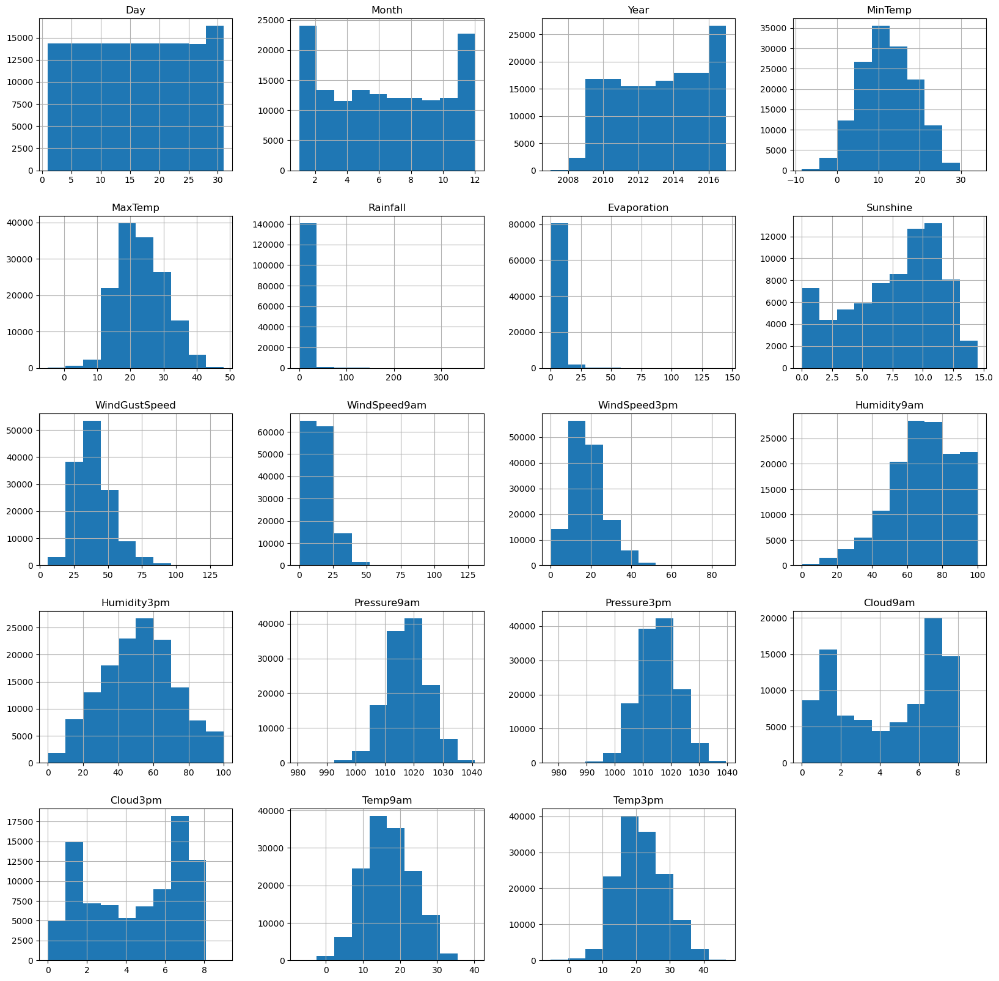

In [10]:
df.hist(bins=10, figsize=(20,20))
plt.show()

### Handling Missing value 

In [11]:
#Missing Value Numerical
df['Evaporation'].fillna(df['Evaporation'].median(), inplace=True)
df['Sunshine'].fillna(df['Sunshine'].median(), inplace=True)
df['Cloud9am'].fillna(df['Cloud9am'].median(), inplace=True)
df['Cloud3pm'].fillna(df['Cloud3pm'].median(), inplace=True)
df['WindGustSpeed'].fillna(df['WindGustSpeed'].median(), inplace=True)
df['Pressure9am'].fillna(df['Pressure9am'].median(), inplace=True)
df['Pressure3pm'].fillna(df['Pressure3pm'].median(), inplace=True)

In [12]:
df.isnull().sum()

Day                  0
Month                0
Year                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation          0
Sunshine             0
WindGustDir      10326
WindGustSpeed        0
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am          0
Pressure3pm          0
Cloud9am             0
Cloud3pm             0
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [13]:
data = df.dropna()

In [14]:
data.isnull().sum()

Day              0
Month            0
Year             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

In [15]:
data.duplicated().sum()

0

In [16]:
#Melihat atribut yang merupakan data categorical
Category = data.select_dtypes(include=['object','category']).columns.tolist()
print('Jumlah atribut categorical : {}'.format(len(Category)))
print('Atribut categorical :', Category)

Jumlah atribut categorical : 6
Atribut categorical : ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


In [17]:
#Melihat atribut yang memiliki data numeric
Numeric = data.select_dtypes(include=['number']).columns.tolist()
print('Jumlah atribut numeric : {}'.format(len(Numeric)))
print('Atribut numeric :', Numeric)

Jumlah atribut numeric : 19
Atribut numeric : ['Day', 'Month', 'Year', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


### Handling Outlier

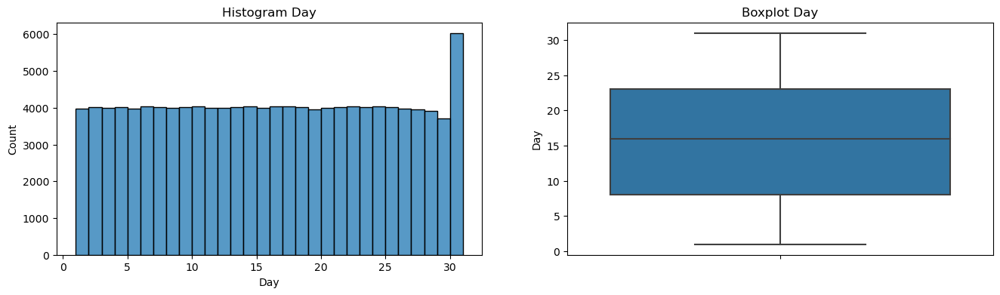

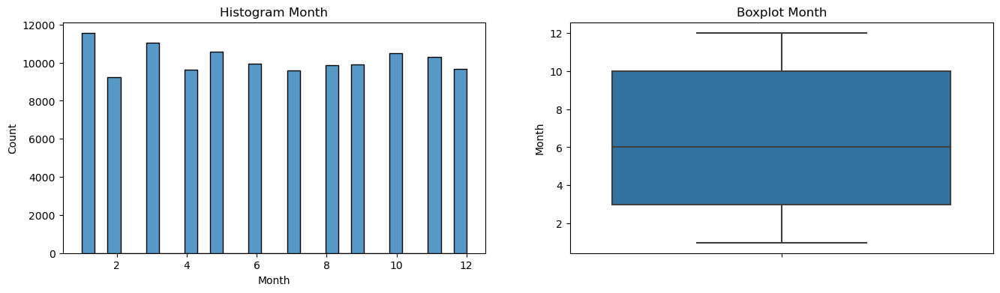

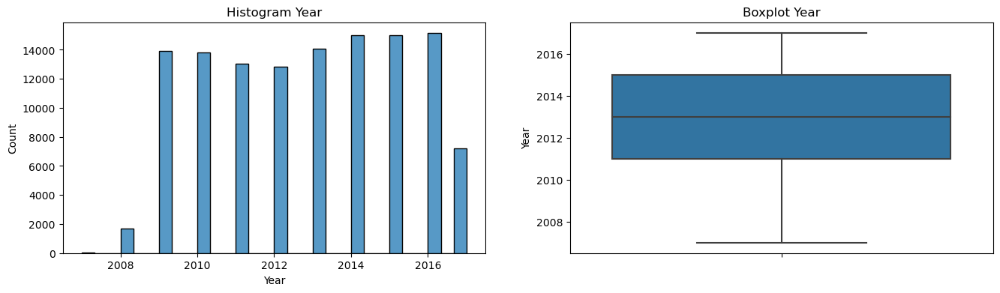

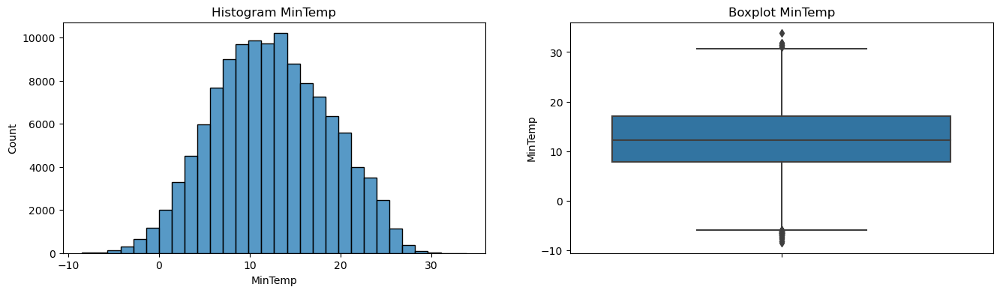

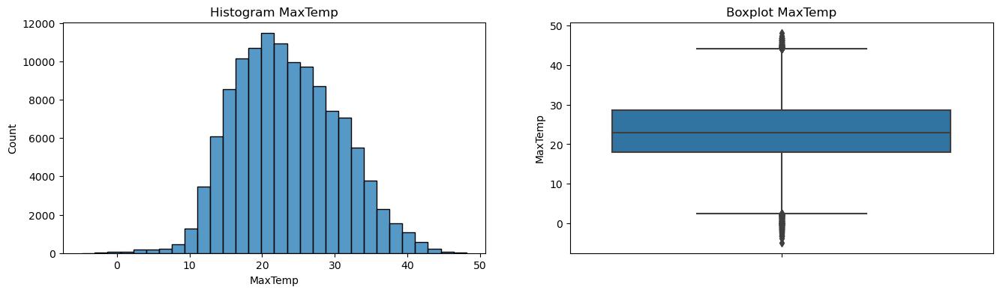

...

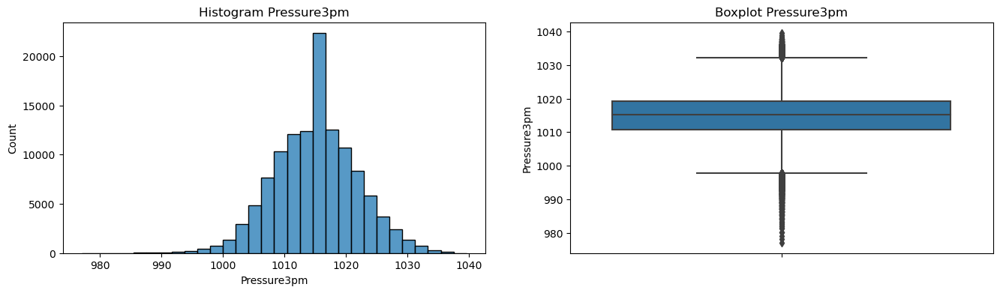

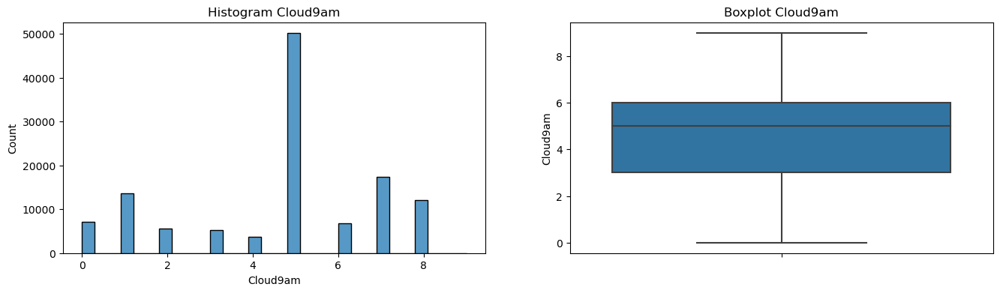

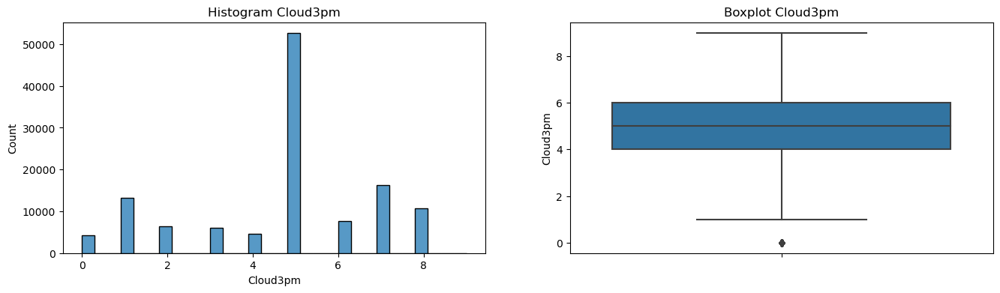

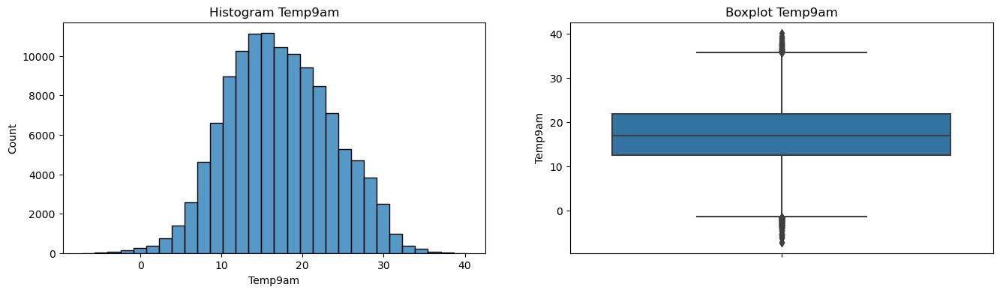

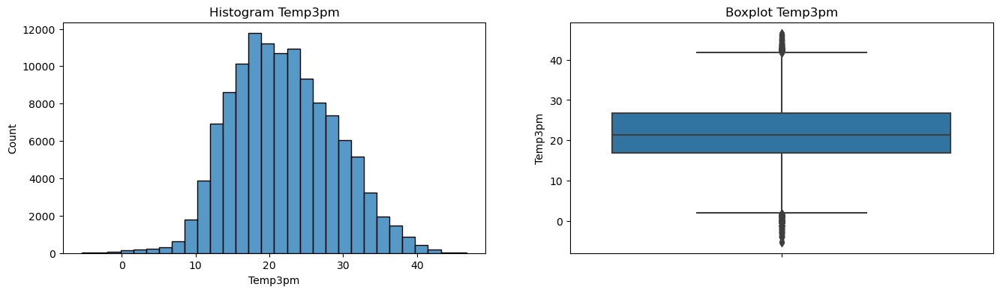

In [18]:
# Membuat histogram dan boxplot untuk setiap atribut numerikal untuk melihat outliers
for columns in Numeric:
    plt.figure(figsize=(16,4))

    #Histogram
    plt.subplot(1,2,1)
    sns.histplot(data[columns],bins=30)
    plt.title(f'Histogram {columns}')

    # Boxplot
    plt.subplot(1,2,2)
    sns.boxplot(y=data[columns])
    plt.title(f'Boxplot {columns}')

    plt.show()

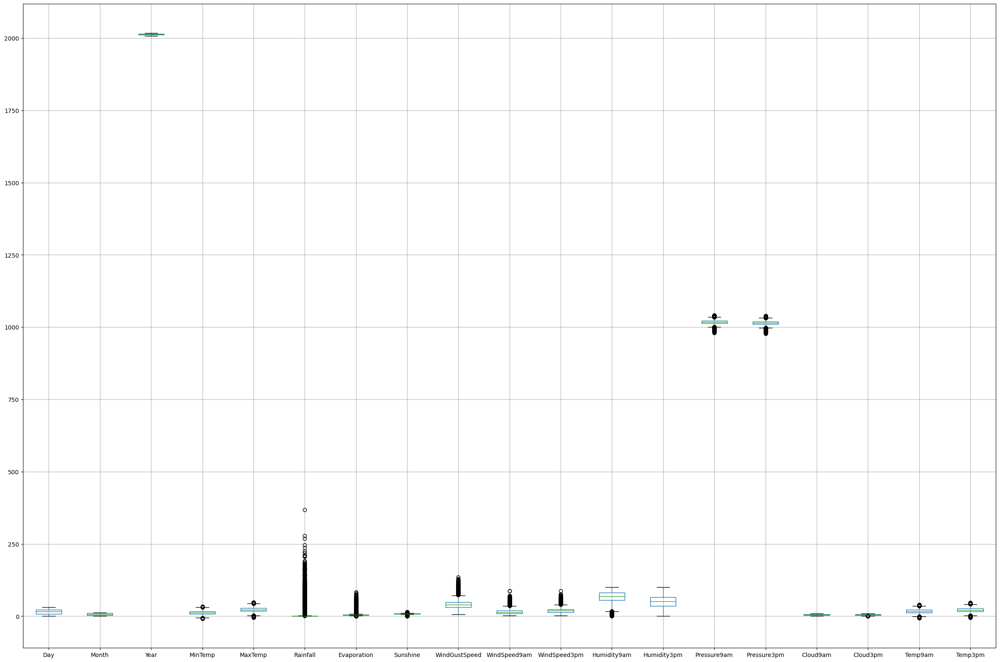

In [19]:
data[Numeric].boxplot(figsize=(30,20))
plt.show()

berdasarkan visualisasi bloxplot diatas atribut yang memiliki outlier yaitu atribut MinTemp, MaxTemp, Rainfall, Evaporation, Sunshine, WindGustSpeed, WindSpeed9am, WindSpeed3pm, Humidity9am, Pressure9am, Pressure3pm, Cloud3pm, Temp9am, dan Temp3pm.

In [20]:
# Memasukkan atribut-atribut yang memiliki outliers besar pada sebuah variable outlier
Outlier = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed','WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Pressure9am', 'Pressure3pm', 'Cloud3pm', 'Temp9am','Temp3pm']
print('Outlier :', Outlier)

Outlier : ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Pressure9am', 'Pressure3pm', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [21]:
for feature in Outlier:
    Q1 = data[feature].quantile(0.25)
    Q3 = data[feature].quantile(0.75)

    IQR = Q3-Q1
    LowerLimit = Q1 - (IQR*1.5)
    UpperLimit = Q3 + (IQR*1.5)

    data.loc[data[feature] < LowerLimit, feature] = LowerLimit
    data.loc[data[feature] > UpperLimit, feature] = UpperLimit

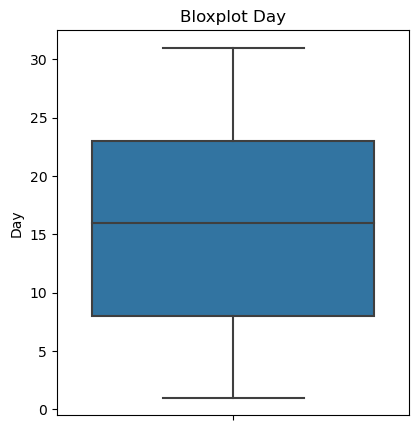

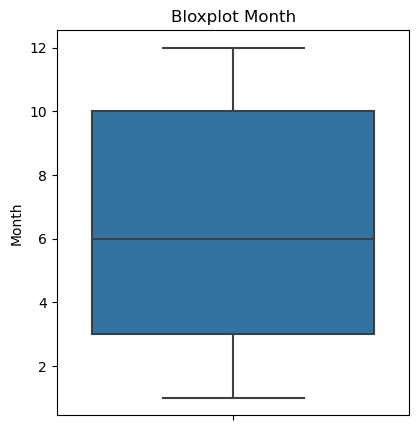

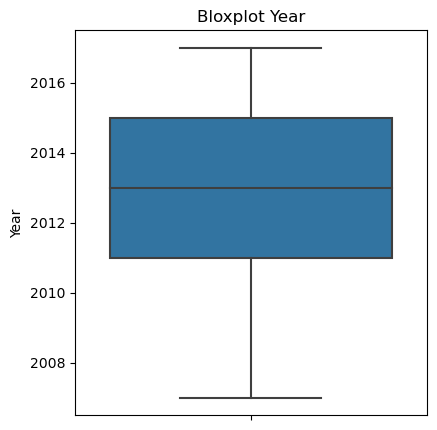

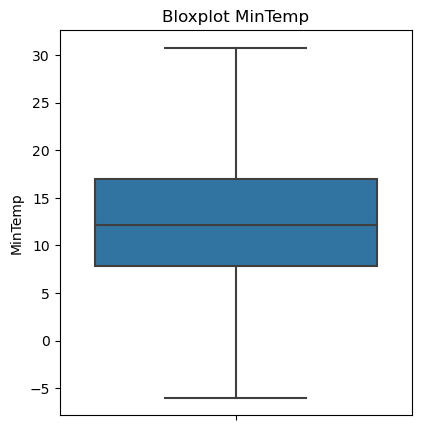

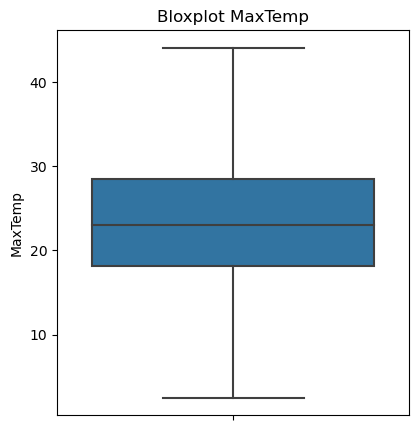

...

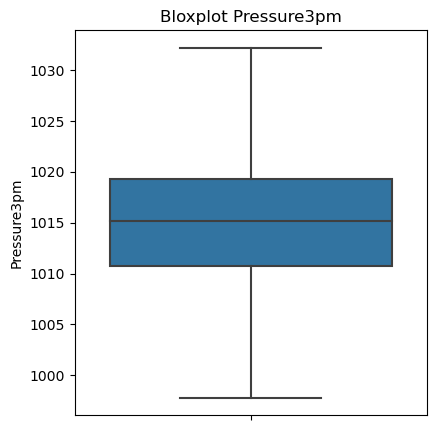

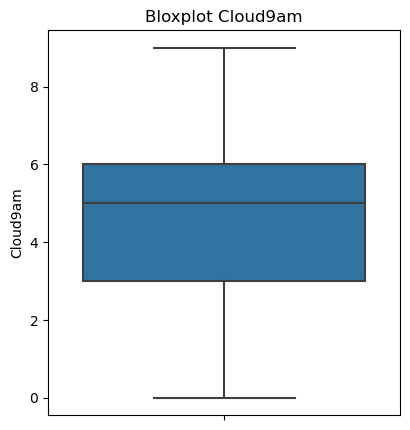

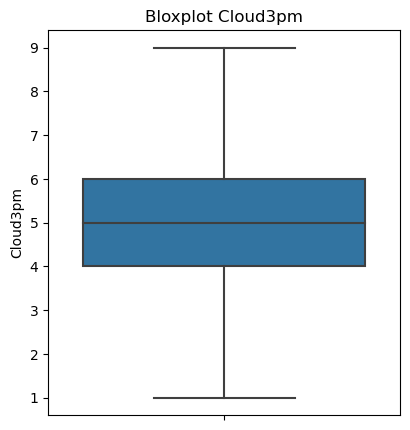

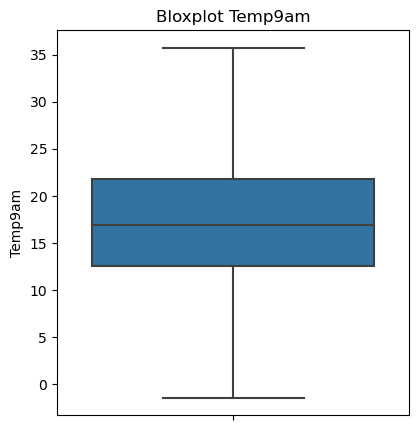

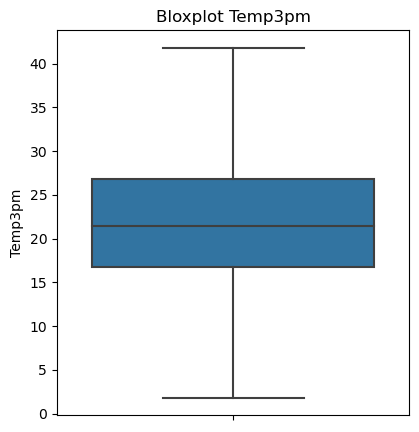

In [22]:
#Bloxplot setiap atribut numeric 
for feature in Numeric:
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 2)
    sns.boxplot(y=data[feature])
    plt.title(f'Bloxplot {feature}')

In [23]:
data.shape

(121790, 25)

---
## Exploratory Data Analysis (EDA)

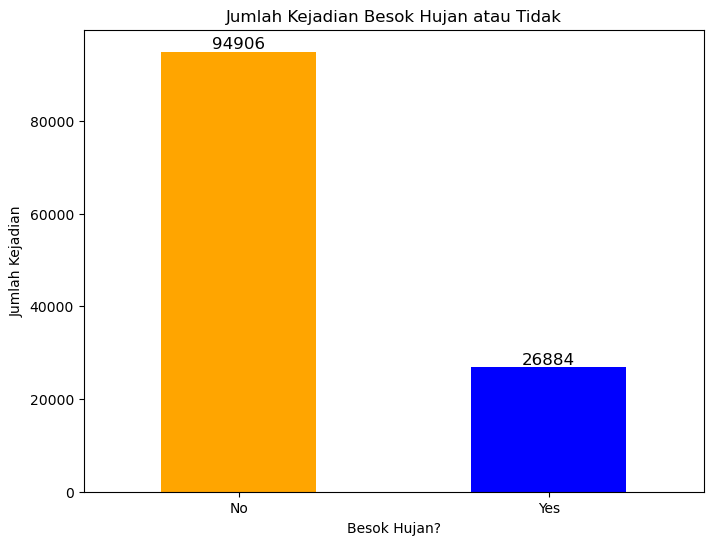

In [24]:
#Menghitung jumlah kejadian cuaca besok
RainTomorrow = data['RainTomorrow'].value_counts()

# Menampilkan visual perbandingan kejadian besok hujan atau tidak
plt.figure(figsize=(8, 6))
RainTomorrow.plot(kind='bar', color=['orange', 'blue'])

for i, count in enumerate(RainTomorrow):
    plt.text(i, count, str(count), ha='center', va='bottom', fontsize=12)

plt.title('Jumlah Kejadian Besok Hujan atau Tidak')
plt.xlabel('Besok Hujan?')
plt.ylabel('Jumlah Kejadian')
plt.xticks(rotation=0)
plt.show()

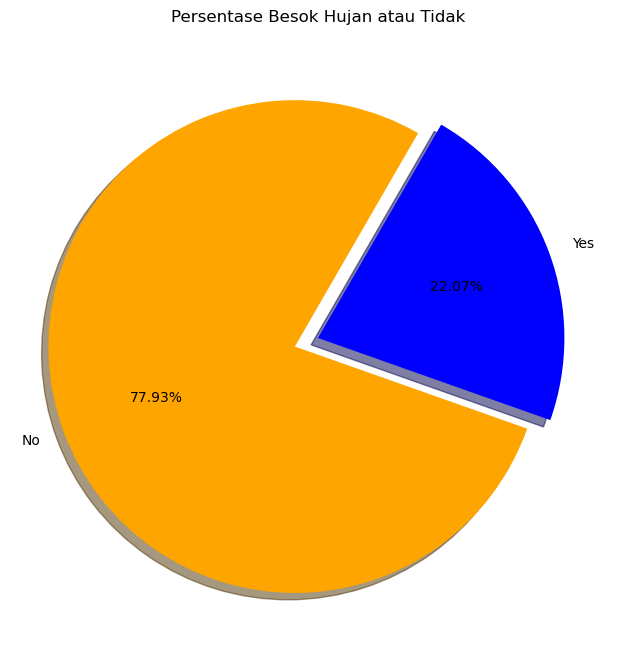

In [25]:
# persentase dari jumlah besok akan turun hujan atau tidak
Label = RainTomorrow.index
Sizes = RainTomorrow.values

plt.figure(figsize=(8, 8))
plt.pie(Sizes, explode=(0.1, 0), labels=Label, colors=['orange', 'blue'], autopct='%1.2f%%', shadow=True, startangle=60)
plt.title('Persentase Besok Hujan atau Tidak')
plt.show()

**Insight:**

Ditemukan bahwa persentase kejadian besok hujan yang dinyatakan sebagai 'yes' adalah sebesar 22.07%, sementara untuk 'no' mencapai 77.93%. 
Jumlah kejadian yang diprediksi tidak akan hujan ('no') sebanyak 94.906 sedangkan kejadian yang diprediksi akan hujan ('yes') mencapai 26.884. Informasi ini menggambarkan distribusi prediksi cuaca diesok hari serta menunjukkan bahwa mayoritas prediksi mengindikasikan tidak adanya hujan.

---

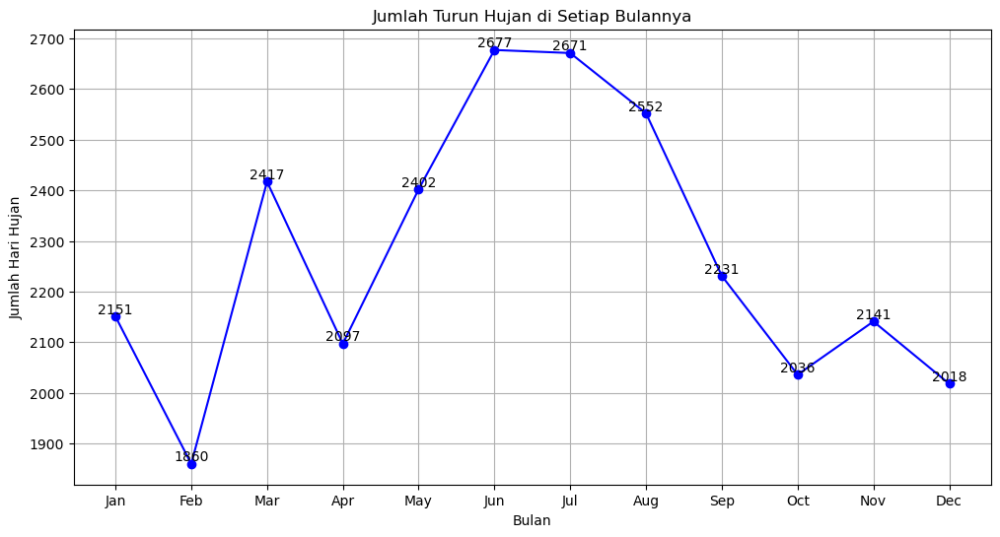

In [26]:
# Menghitung jumlah hari dengan hujan (RainToday == 'Yes') setiap bulan
RainMonth = data[data['RainToday'] == 'Yes'].groupby('Month')['RainToday'].count()

# Membuat line chart
plt.figure(figsize=(12, 6))
plt.plot(RainMonth.index, RainMonth, marker='o', linestyle='-', color='blue')

# Menambahkan label pada titik data
for i, j in zip(RainMonth.index, RainMonth):
    plt.text(i, j, str(j), ha='center', va='bottom', fontsize=10)

plt.title('Jumlah Turun Hujan di Setiap Bulannya')
plt.xlabel('Bulan')
plt.ylabel('Jumlah Hari Hujan')
plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True)
plt.show()

**Insight:**

Berdasarkan grafik tersebut, terlihat bahwa puncak turunnya hujan pada bulan Juni sekitar 2677 kali selama 10 tahun. Namun pada bulan Februari merupakan bulan terendah turunnya hujan yang berkisar hanya 1860 kali selama 10 tahun, sehingga menciptakan kontras yang signifikan antara dua bulan tersebut. 

---

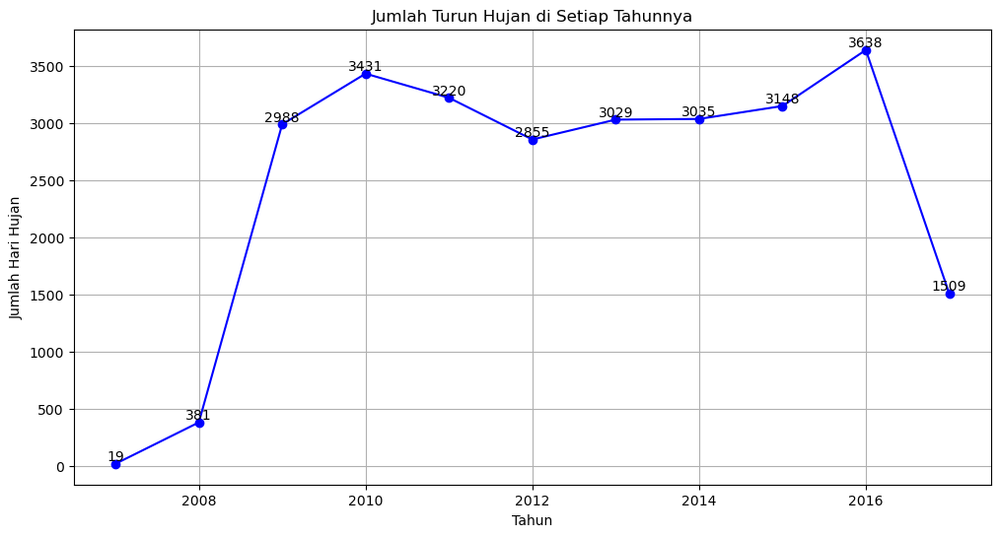

In [27]:
# Menghitung jumlah hari dengan hujan (RainToday == 'Yes') setiap tahun
RainyYear = data[data['RainToday'] == 'Yes'].groupby('Year')['RainToday'].count()

# Membuat line chart
plt.figure(figsize=(12, 6))
plt.plot(RainyYear.index, RainyYear, marker='o', linestyle='-', color='blue')

# Menambahkan label pada titik data
for i, j in zip(RainyYear.index, RainyYear):
    plt.text(i, j, str(j), ha='center', va='bottom', fontsize=10)

plt.title('Jumlah Turun Hujan di Setiap Tahunnya')
plt.xlabel('Tahun')
plt.ylabel('Jumlah Hari Hujan')
plt.grid(True)
plt.show()

**Insight:**

Berdasarkan grafik line chart diatas, dapat diamati bahwa tahun 2016 melonjak sebagai tahun dengan jumlah turun hujan terbanyak dibandingkan tahun tahun sebelumnya, sementara pada tahun 2007 mencatat jumlah turun hujan yang terendah. Pembandingan antara dua tahun tersebut memberikan gambaran jelas tentang fluktuasi ekstrem dalam curah hujan selama periode yang diobservasi. Tahun 2016 menunjukkan tren kenaikan yang signifikan, sementara tahun 2007 menonjol sebagai tahun dengan tingkat curah hujan terendah dalam rentang waktu tersebut.

---

In [28]:
#Comparison Temp and Rain fall
fig = px.scatter(data, x='Temp9am', y='Temp3pm', color='Rainfall', hover_data=['Temp9am', 'Temp3pm', 'Rainfall'])
fig.update_layout(title='Comparison Temp and Rainfall')

fig.show()

In [29]:
#Comparison Pressure and Rain fall
fig = px.scatter(data, x='Pressure9am', y='Pressure3pm', color='Rainfall', hover_data=['Pressure9am', 'Pressure3pm', 'Rainfall'])
fig.update_layout(title='Comparison Pressure and Rainfall')

fig.show()

---
## Measure of Central Tendency

In [30]:
#Mengetahui nilai rata rata dari temp disetiap tahunnya
MeanTemp = data.groupby('Year')[['MinTemp', 'MaxTemp']].mean()
MeanTemp

,MinTemp,MaxTemp
Year,,
2007,12.545902,25.086885
2008,12.438354,23.343316
2009,12.428417,23.610144
2010,12.384078,22.894453
2011,12.375448,22.871424
2012,11.607595,22.722028
2013,12.123645,23.501620
2014,12.597611,24.016473
2015,12.374508,23.711809


In [31]:
#Mengetahui nilai tengah dari atribut WindGustSpeed
MedianWindGustSpeed = data['WindGustSpeed'].median()
MedianWindGustSpeed

39.0

In [32]:
#Mengetahui Location mana yang paling sering turun hujan
Rain = data[data['RainToday'] == 'Yes']
ModeLocation = data['Location'].mode()
ModeLocation

0    Darwin
Name: Location, dtype: object

**Insight Measure of Central Tendency**
- **Mean:** Rata-rata suhu minimum dan maksimum cenderung bervariasi setiap tahun. Pada tahun 2012, terjadi penurunan yang signifikan dalam suhu minimum, pada tahun 2017, terjadi peningkatan yang signifikan dalam suhu maksimum.
- **Median:** Nilai tengah dari atribut WindGustSpeed yaitu **39.0**
- **Mode:** Lokasi yang sering turun hujan adalah lokasi Darwin.

---

## Measure of Spread

In [33]:
# Menghitung range
min_rainfall = data['Rainfall'].min()
max_rainfall = data['Rainfall'].max()

print(min_rainfall, max_rainfall)

0.0 2.0


In [34]:
# Menghitung measure of spread (deviasi standar)
rainfall_std = data['Rainfall'].std()

# Menampilkan hasil
print(f'Standard Deviation of Rainfall: {rainfall_std}')

Standard Deviation of Rainfall: 0.7922952058519201


**Insight Measure of Spread**
- Range dari atribut rainfall atau curah hujan sekitar 0.0 mm hingga 2.0 mm.
- Hasil pengukuran penyebaran data pada atribut Rainfall melalui standard deviasi yaitu memiliki nilai sebesar  0.7922952058519201.

---

## Data Preprocessing

In [35]:
#Correlation matrix
data[Numeric].corr()

,Day,Month,Year,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
Day,1.000000,0.014899,-0.005230,0.000019,-0.002921,0.004545,-0.009434,-0.008098,-0.009200,-0.007222,-0.008885,0.015820,0.014481,-0.021321,-0.021246,0.006595,-0.000906,-0.001963,-0.004338
Month,0.014899,1.000000,-0.118537,-0.210761,-0.167820,0.010980,-0.022303,0.011377,0.054102,0.041867,0.057274,-0.083777,-0.017883,0.042142,0.031789,-0.005269,-0.003502,-0.141296,-0.175377
Year,-0.005230,-0.118537,1.000000,0.027519,0.042493,-0.014339,0.044465,-0.002722,-0.033017,-0.027935,-0.042529,0.014510,-0.001195,0.038760,0.035327,0.066256,0.041334,0.027941,0.041660
MinTemp,0.000019,-0.210761,0.027519,1.000000,0.735128,0.040535,0.443215,0.089038,0.153313,0.146342,0.162568,-0.219338,0.001760,-0.421844,-0.433741,0.038594,-0.010121,0.897781,0.711166
MaxTemp,-0.002921,-0.167820,0.042493,0.735128,1.000000,-0.268969,0.528677,0.348665,0.048881,-0.009729,0.030325,-0.511042,-0.513760,-0.305023,-0.396551,-0.238616,-0.229637,0.890496,0.984796
Rainfall,0.004545,0.010980,-0.014339,0.040535,-0.268969,1.000000,-0.211252,-0.268969,0.158183,0.102353,0.089690,0.414771,0.423005,-0.182688,-0.095911,0.265244,0.230845,-0.132905,-0.274642
Evaporation,-0.009434,-0.022303,0.044465,0.443215,0.528677,-0.211252,1.000000,0.383748,0.151562,0.129719,0.114810,-0.419121,-0.309545,-0.251008,-0.277413,-0.183020,-0.188748,0.515489,0.513227
Sunshine,-0.008098,0.011377,-0.002722,0.089038,0.348665,-0.268969,0.383748,1.000000,-0.050714,0.000007,0.007555,-0.366464,-0.423073,0.035683,-0.018766,-0.551191,-0.562401,0.247243,0.367029
WindGustSpeed,-0.009200,0.054102,-0.033017,0.153313,0.048881,0.158183,0.151562,-0.050714,1.000000,0.590483,0.677799,-0.183740,-0.015686,-0.423173,-0.379124,0.057480,0.086159,0.118229,0.011195
WindSpeed9am,-0.007222,0.041867,-0.027935,0.146342,-0.009729,0.102353,0.129719,0.000007,0.590483,1.000000,0.497017,-0.224690,-0.015255,-0.192059,-0.143143,0.007174,0.035691,0.088032,-0.023059


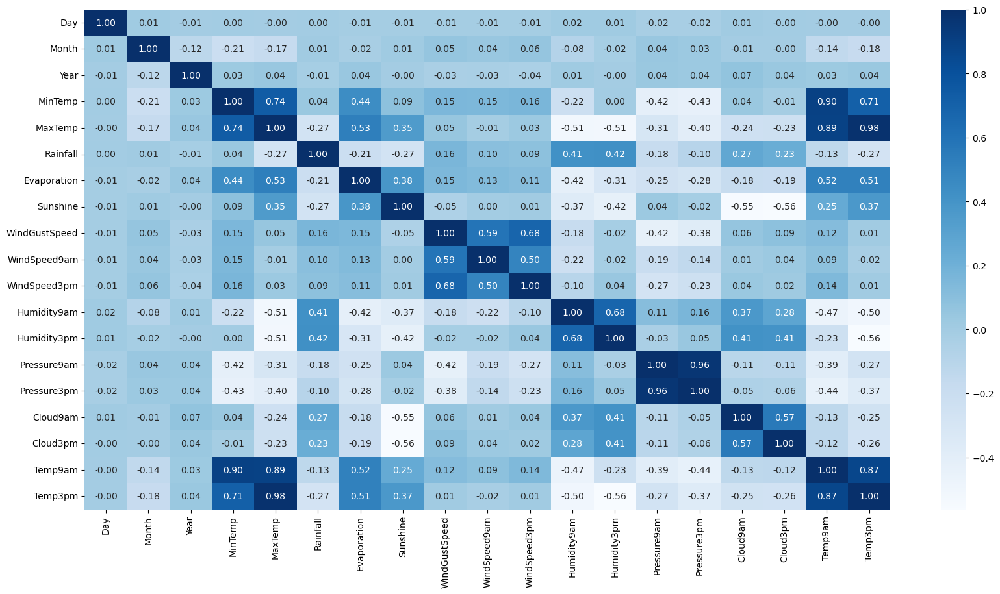

In [36]:
plt.figure(figsize=(20, 10))
ax = sns.heatmap(data[Numeric].corr(), annot=True, fmt='.2f', cmap='Blues')

In [37]:
data.columns

Index(['Day', 'Month', 'Year', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall',
       'Evaporation', 'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am',
       'WindDir3pm', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [38]:
print('categorical :', Category)
print('numerical :', Numeric)

categorical : ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']
numerical : ['Day', 'Month', 'Year', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [39]:
# Encode atribut category menggunakan replace function pada atribut bertipe Object
data['RainToday'].replace({'No':0, 'Yes': 1}, inplace = True)
data['RainTomorrow'].replace({'No':0, 'Yes': 1}, inplace = True)

In [40]:
#membuat fungsi yang akan mengkodekan nilai-nilai unik dalam suatu atribut
def EncodeData(attribut):

    MappingDict = {}
    UniqueValues = list(data[attribut].unique())
    for idx in range(len(UniqueValues)):
        MappingDict[UniqueValues[idx]] = idx
    print(MappingDict)
    return MappingDict

In [41]:
data['Location'].replace(EncodeData('Location'),inplace = True)
data['WindGustDir'].replace(EncodeData('WindGustDir'),inplace = True)
data['WindDir9am'].replace(EncodeData('WindDir9am'),inplace = True)
data['WindDir3pm'].replace(EncodeData('WindDir3pm'),inplace = True)

{'Albury': 0, 'BadgerysCreek': 1, 'Cobar': 2, 'CoffsHarbour': 3, 'Moree': 4, 'NorahHead': 5, 'NorfolkIsland': 6, 'Penrith': 7, 'Richmond': 8, 'Sydney': 9, 'SydneyAirport': 10, 'WaggaWagga': 11, 'Williamtown': 12, 'Wollongong': 13, 'Canberra': 14, 'Tuggeranong': 15, 'MountGinini': 16, 'Ballarat': 17, 'Bendigo': 18, 'Sale': 19, 'MelbourneAirport': 20, 'Melbourne': 21, 'Mildura': 22, 'Nhil': 23, 'Portland': 24, 'Watsonia': 25, 'Dartmoor': 26, 'Brisbane': 27, 'Cairns': 28, 'GoldCoast': 29, 'Townsville': 30, 'Adelaide': 31, 'MountGambier': 32, 'Nuriootpa': 33, 'Woomera': 34, 'Witchcliffe': 35, 'PearceRAAF': 36, 'PerthAirport': 37, 'Perth': 38, 'SalmonGums': 39, 'Walpole': 40, 'Hobart': 41, 'Launceston': 42, 'AliceSprings': 43, 'Darwin': 44, 'Katherine': 45, 'Uluru': 46}


{'W': 0, 'WNW': 1, 'WSW': 2, 'NE': 3, 'NNW': 4, 'N': 5, 'NNE': 6, 'SW': 7, 'ENE': 8, 'SSE': 9, 'S': 10, 'NW': 11, 'SE': 12, 'ESE': 13, 'E': 14, 'SSW': 15}
{'W': 0, 'NNW': 1, 'SE': 2, 'ENE': 3, 'SW': 4, 'SSE': 5, 'S': 6, 'NE': 7, 'SSW': 8, 'N': 9, 'WSW': 10, 'ESE': 11, 'E': 12, 'NW': 13, 'WNW': 14, 'NNE': 15}
{'WNW': 0, 'WSW': 1, 'E': 2, 'NW': 3, 'W': 4, 'SSE': 5, 'ESE': 6, 'ENE': 7, 'NNW': 8, 'SSW': 9, 'SW': 10, 'SE': 11, 'N': 12, 'S': 13, 'NNE': 14, 'NE': 15}


In [42]:
data.head()

,Day,Month,Year,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,1,12,2008,0,13.4,22.9,0.6,4.8,8.4,0,44.0,0,0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0,0
1,2,12,2008,0,7.4,25.1,0.0,4.8,8.4,1,44.0,1,1,4.0,22.0,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0,0
2,3,12,2008,0,12.9,25.7,0.0,4.8,8.4,2,46.0,0,1,19.0,26.0,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0,0
3,4,12,2008,0,9.2,28.0,0.0,4.8,8.4,3,24.0,2,2,11.0,9.0,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0,0
4,5,12,2008,0,17.5,32.3,1.0,4.8,8.4,0,41.0,3,3,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0


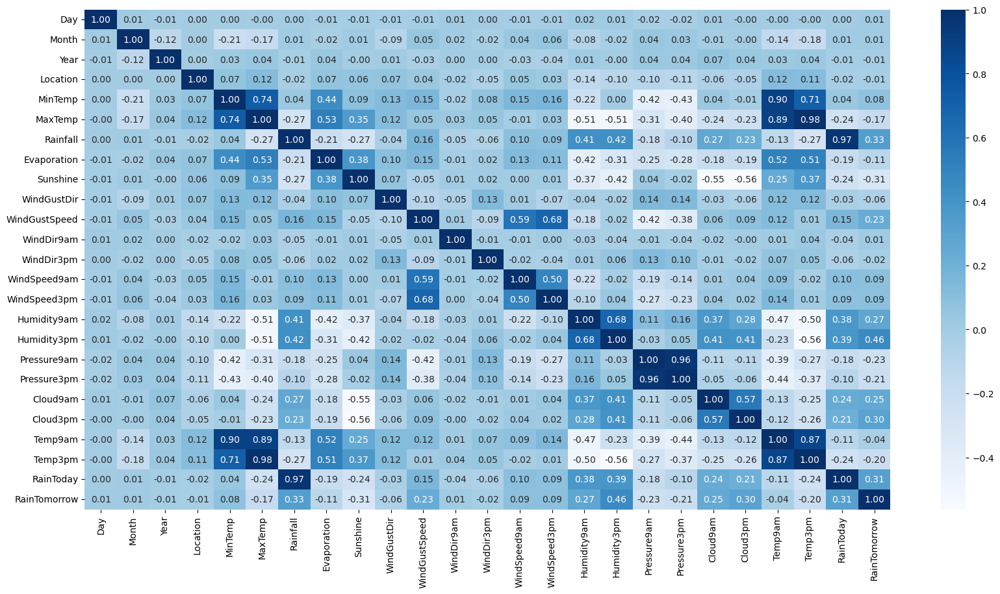

In [43]:
plt.figure(figsize=(20, 10))
ax = sns.heatmap(data.corr(), annot=True, fmt='.2f', cmap='Blues')

### Feature Selection

In [44]:
Transform = data.drop(['RainTomorrow'], axis=1)
print(Transform.shape)

(121790, 24)


In [45]:
y = data['RainTomorrow']
print(y.shape)

(121790,)


selanjutnya melakukan pemilihan fitur (feature selection) dalam analisis data, dengan tujuan untuk mengidentifikasi dan mempertahankan 10 fitur terbaik dari data berdasarkan relevansi mereka terhadap variabel target(y).

In [46]:
TopAttribute = SelectKBest(score_func=f_regression, k=10)
Fit = TopAttribute.fit(Transform,y)
DataScores = pd.DataFrame(Fit.scores_)
DataColumns = pd.DataFrame(Transform.columns)

AttributScores = pd.concat([DataColumns, DataScores], axis=1 )
AttributScores.columns = ['Specs','Score']

print("best 10 features are")
print(AttributScores.nlargest(10,'Score'))

best 10 features are
            Specs         Score
16    Humidity3pm  31804.180838
6        Rainfall  15264.373343
23      RainToday  13280.472968
8        Sunshine  13051.051563
20       Cloud3pm  12095.265067
15    Humidity9am   9897.783360
19       Cloud9am   8344.651155
10  WindGustSpeed   7008.286239
17    Pressure9am   6978.962156
18    Pressure3pm   5830.367408


In [47]:
X = data[['Humidity3pm', 'Rainfall', 'Sunshine', 'RainToday', 'Cloud3pm', 'Humidity9am', 'Cloud9am', 'WindGustSpeed', 'Pressure9am', 'Pressure3pm']]
X.head(3)

,Humidity3pm,Rainfall,Sunshine,RainToday,Cloud3pm,Humidity9am,Cloud9am,WindGustSpeed,Pressure9am,Pressure3pm
0,22.0,0.6,8.4,0,5.0,71.0,8.0,44.0,1007.7,1007.1
1,25.0,0.0,8.4,0,5.0,44.0,5.0,44.0,1010.6,1007.8
2,30.0,0.0,8.4,0,2.0,38.0,5.0,46.0,1007.6,1008.7


---
## Data Modelling

In [48]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

### Melatih dan Evaluasi Model Logistic Regression

Logistic regression dapat memberikan hasil yang mudah diinterpretasikan, Cocok untuk kasus di mana hubungan antara variabel independen dan dependen dapat diaproksimasi dengan fungsi linear, cenderung lebih cepat dilatih dikarenakan algoritmanya lebih sederhana serta logistic regression memberikan output dalam bentuk probabilitas, yang dapat diinterpretasikan sebagai kepercayaan model terhadap kelas tertentu.

In [49]:
ModelLr = LogisticRegression()

In [50]:
ModelLr.fit(X_train, y_train)

LogisticRegression()

In [51]:
y_predLr = ModelLr.predict(X_test)

In [52]:
AccuracyLr = accuracy_score(y_test, y_predLr)
print('Akurasi:', AccuracyLr)

Akurasi: 0.8455811916687194


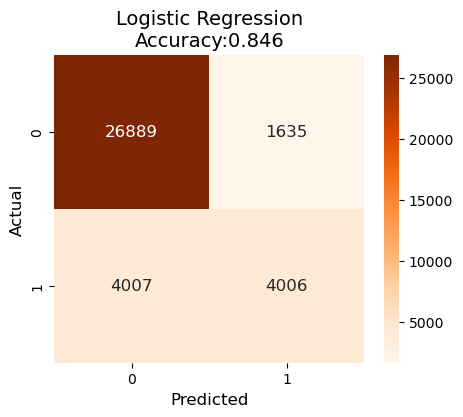

Classification Report:
               precision    recall  f1-score   support

           0       0.87      0.94      0.91     28524
           1       0.71      0.50      0.59      8013

    accuracy                           0.85     36537
   macro avg       0.79      0.72      0.75     36537
weighted avg       0.84      0.85      0.84     36537



In [53]:
#Confussion Logistic Regression
cm = confusion_matrix(y_test, y_predLr)

# Membuat heatmap untuk confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm, annot=True, fmt='.0f', cmap='Oranges', annot_kws={'fontsize':12})
plt.title('Logistic Regression\nAccuracy:{:.3f}'.format(accuracy_score(y_test, y_predLr)), fontsize=14)
plt.xlabel("Predicted", fontsize=12)
plt.ylabel("Actual", fontsize=12)
plt.show()

# Menampilkan Classification Report
print("Classification Report:\n", classification_report(y_test, y_predLr))

Berdasarkan hasil confusion matrix dari model logistic regression diperoleh bahwa:
- nilai TP (True Positive) : 26889
- nilai FP (False Positive) : 1635
- nilai TN (True Negative) : 4007
- nilai FN (False Negative) : 4006

---

### Melatih dan Evaluasi Model SVM

SVM dapat menangani masalah klasifikasi non-linear melalui penggunaan fungsi kernel, memungkinkan pemodelan yang lebih kompleks dapat memberikan performa yang baik dalam mengatasi overfitting dan umumnya memiliki ketahanan yang baik terhadap outlier dan Efektif dalam ruang fitur berdimensi tinggi, yang membuat SVM menjadi pilihan yang baik untuk data dengan banyak fitur.

In [54]:
Svm = SVC()

In [55]:
Svm.fit(X_train, y_train)

SVC()

In [56]:
y_predSvm = Svm.predict(X_test)

In [57]:
AccuracySvm = accuracy_score(y_test, y_predSvm)
print('Akurasi:', AccuracySvm)

Akurasi: 0.8416126118728959


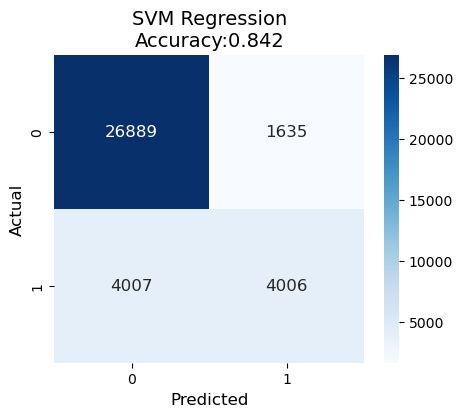

Classification Report:
               precision    recall  f1-score   support

           0       0.85      0.97      0.90     28524
           1       0.77      0.40      0.53      8013

    accuracy                           0.84     36537
   macro avg       0.81      0.68      0.72     36537
weighted avg       0.83      0.84      0.82     36537



In [58]:
#SVM Regression
cm2 = confusion_matrix(y_test, y_predSvm)

# Membuat heatmap untuk confusion matrix
plt.figure(figsize=(5,4))
sns.heatmap(cm, annot=True,fmt='.0f', cmap='Blues', annot_kws={'fontsize':12})
plt.title('SVM Regression\nAccuracy:{:.3f}'.format(accuracy_score(y_test, y_predSvm)), fontsize=14)
plt.xlabel('Predicted', fontsize=12)
plt.ylabel('Actual', fontsize=12)
plt.show()

# Menampilkan Classification Report
print('Classification Report:\n', classification_report(y_test, y_predSvm))

Berdasarkan hasil confusion matrix dari model Support Vector Machine diperoleh bahwa:
- nilai TP (True Positive) : 26889
- nilai FP (False Positive) : 1635
- nilai TN (True Negative) : 4007
- nilai FN (False Negative) : 4006

---

### Tunning pada Model Logistic Regression

Melakukan tuning parameter C pada model Logistic Regression dengan menggunakan metode cross-validation sehingga bertujuan untuk menemukan nilai optimal dari parameter C yang memberikan recall score tertinggi pada data uji.

1st max value of 0.788 occurred at C=3.700


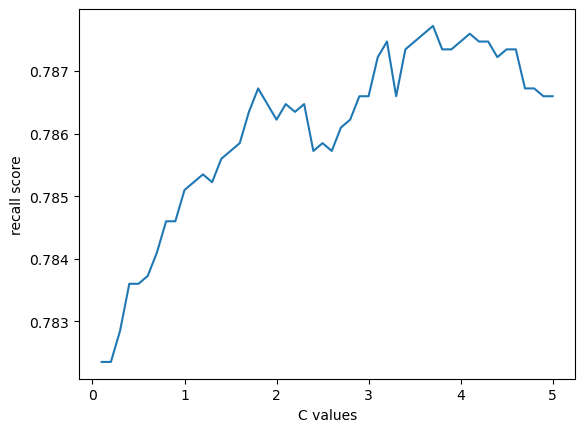

In [59]:
C_start = 0.1
C_end = 5
C_inc = 0.1

C_values, recall_scores = [], []

C_val = C_start
best_recall_score = 0
best_lr_predict_test = None  # Initialize the variable

while C_val < C_end:
    C_values.append(C_val)
    lr_model_loop = LogisticRegression(C=C_val, class_weight='balanced', random_state=42, solver='liblinear', max_iter=1000)
    lr_model_loop.fit(X_train, y_train.ravel())
    lr_predict_loop_test = lr_model_loop.predict(X_test)
    recall_score = metrics.recall_score(y_test, lr_predict_loop_test)
    recall_scores.append(recall_score)
    
    if recall_score > best_recall_score:
        best_recall_score = recall_score
        best_lr_predict_test = lr_predict_loop_test

    C_val += C_inc

best_score_C_val = C_values[recall_scores.index(best_recall_score)]
print('1st max value of {0:.3f} occurred at C={1:.3f}'.format(best_recall_score, best_score_C_val))

plt.plot(C_values, recall_scores, '-')
plt.xlabel('C values')
plt.ylabel('recall score')
plt.show()

In [60]:
lr_model = LogisticRegression(class_weight='balanced', C=best_score_C_val, random_state=42, solver='liblinear')
lr_model.fit(X_train, y_train.ravel())

lr_predict_test = lr_model.predict(X_test)

# Training metrics
print('Accuracy: {:.4f}'.format(metrics.accuracy_score(y_test, lr_predict_test)))

print('Confusion Matrix:')
print(metrics.confusion_matrix(y_test, lr_predict_test))
print('')

print('Classification Report:')
print(metrics.classification_report(y_test, lr_predict_test))

print('Recall Score: {:.4f}'.format(metrics.recall_score(y_test, lr_predict_test)))

Accuracy: 0.7871
Confusion Matrix:
[[22447  6077]
 [ 1701  6312]]

Classification Report:
              precision    recall  f1-score   support

           0       0.93      0.79      0.85     28524
           1       0.51      0.79      0.62      8013

    accuracy                           0.79     36537
   macro avg       0.72      0.79      0.74     36537
weighted avg       0.84      0.79      0.80     36537

Recall Score: 0.7877


---
## Model Inference

In [61]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 121790 entries, 0 to 145458
Data columns (total 10 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Humidity3pm    121790 non-null  float64
 1   Rainfall       121790 non-null  float64
 2   Sunshine       121790 non-null  float64
 3   RainToday      121790 non-null  int64  
 4   Cloud3pm       121790 non-null  float64
 5   Humidity9am    121790 non-null  float64
 6   Cloud9am       121790 non-null  float64
 7   WindGustSpeed  121790 non-null  float64
 8   Pressure9am    121790 non-null  float64
 9   Pressure3pm    121790 non-null  float64
dtypes: float64(9), int64(1)
memory usage: 10.2 MB


In [62]:
DataInference = {
    'Humidity3pm': [10.0, 23.0, 27.0],
    'Rainfall': [2.4, 0.0, 1.7],
    'Sunshine': [7.9, 8.2, 7.1],
    'RainToday': [1, 0, 1],
    'Cloud3pm': [5.2, 2.0, 8.9],
    'Humidity9am': [82.0, 23.9, 45.0],
    'Cloud9am': [5.2, 2.0, 8.9],
    'WindGustSpeed': [46.0, 25.0, 39.0],
    'Pressure9am': [1001, 1013, 1021],
    'Pressure3pm': [1008, 1015, 1019]
}
DataInference = pd.DataFrame(DataInference)

In [63]:
y_predInference1 = ModelLr.predict(DataInference)
print('Logistic Regression:', y_predInference1)

Logistic Regression: [0 0 0]


In [64]:
y_predInference2 = Svm.predict(DataInference)
print('Support Vector Machine:', y_predInference2)

Support Vector Machine: [0 0 0]


---
---
**INSIGHT KESELURUHAN:**

1. "WeatherAUS" adalah sekumpulan data yang berisikan pengamatan cuaca harian yang ada disetiap wilayah negara australia, selama sekitar 10 tahun, Dataset ini mencangkup aspek cuaca seperti, kelembaban, suhu, curah hujan, cakupan awan, dan perkiraan cuaca. Ada 145460 entries dalam dataset ini dengan 23 atribut yang mencangkup informasi tentang cuaca harian.
2. Atribut "RainTomorrow" adalah target variabel dalam dataset ini. Jika nilainya adalah "Yes," itu berarti bahwa besok kemungkinan akan turun hujan. Dataset ini bermanfaat untuk analisis cuaca, pemodelan cuaca, dan pengembangan sistem peramalan cuaca.
3. Dalam Explorary Data Analysis, kami menggunakan beberapa jenis grafik diantaranya bar chart, pie chart, line chart dan scatter.  
    - Visualisasi pie chart kami gunakan untuk mengetahui perbandingan jumlah kejadian besok hujan atau tidak dalam bentuk persentase yang dimana hasil visualisasi menunjukkan bahwa no 77.93% sedangkan yes hanya sekitar 22.07%.
    - Visulisasi bar kami gunakan untuk menghitung jumlah perbandingan hujan atau tidak, hasilnya adalah no yang menunjukan bahwa model cenderung memprediksi cuaca tidak hujan.
    - Visualisasi Line Chart kami gunakan untuk menghitung jumlah turunnya hujan berdasarkan tahun dan bulan.
    - Visualisasi Scatter kami gunakan untuk mengcomper atribut temp, pressure terhadap atribut rainfall.
4. Dalam menentukan hasil prediksi cuaca akan hujan atau tidak kami memnggunakan algoritma linear regression dan algoritma svm sebagai pembanding nilai akurasi.
   - Pemodelan menggunakan algoritma Logistic regression menghasilkan nilai akurasi sebesar **84.6%**
   - Pemodelan menggunakan algoritma Support Vector Machine menghasilkan nilai akurasi sebesar **84.2%**
5. Setelah melakukan tunning parameter C pada model Logistic Regression dengan menggunakan metode cross-validation, kini akurasi model yang didapatkan hanya sekitar 0.7871, yang mengindikasikan bahwa sekitar 78.71% dari prediksi model benar. Terdapat empat nilai dalam confusion matrix:
      - True Positives (TP): 22447, yang merupakan jumlah kasus positif yang benar diprediksi.
      - True Negatives (TN): 1701, yang merupakan jumlah kasus negatif yang benar diprediksi.
      - False Positives (FP): 6077, yang merupakan jumlah kasus negatif yang salah diprediksi sebagai positif.
      - False Negatives (FN): 6312, yang merupakan jumlah kasus positif yang salah diprediksi sebagai negatif.
6. Dari kedua algoritma tersebut, algoritma yang lebih direkomendasikan untuk memprediksi cuaca besok apakah hujan atau tidak adalah algoritma **Logistic Regression**. Alasan memilih Logistic Regression karena memiliki recall yang baik untuk kelas 1 dibandingkan dengan SVM. Meskipun precision untuk kelas 1 lebih rendah, tetapi recall yang lebih tinggi dapat dianggap lebih penting dalam konteks prediksi cuaca untuk mengidentifikasi sebanyak mungkin kasus hujan yang sebenarnya, sehingga nilai recall lebih diutamakan dan interpretabilitas yang baik dari Logistic Regression dapat memberikan pemahaman yang lebih baik tentang faktor-faktor yang mempengaruhi prediksi hujan.

---
---